In [1]:
import torch
from PIL import Image
import torch.nn.functional as F
import torchvision.transforms.functional as TF
from torchvision import transforms, models
import numpy as np # linear algebra
import random
import math
import matplotlib.pyplot as plt
import os
import glob
import time
import sys

img_h = 1536
img_w = 1536

crop_h = 384
crop_w = 384
'''
seed = int(time.time()%(time.time()+256)+23*(time.time())**3+time.time()*(356*(278+time.time())))%1000
seed=832
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cudnn.deterministic = True
'''
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

n_classes = 2
#1918*1280 

mean=[0.485, 0.456, 0.406]
std=[0.229, 0.224, 0.225]

In [4]:
import shutil 
from tqdm import tqdm

train_dir = 'train'
val_dir = 'val'

class_names = ['data', 'answer']

for dir_name in [train_dir, val_dir]:
    for class_name in class_names:
        os.makedirs(os.path.join(dir_name, class_name, 'unknown'), exist_ok=True)
source_dir  = os.path.join('../input/massachusetts-roads-datasetrework/train')
source_dir0 = os.path.join('../input/massachusetts-roads-datasetrework/train_mask')
for i, file_name in enumerate(tqdm(os.listdir(source_dir))):
    if i % 13 != 0:
        dest_dir  = os.path.join(train_dir, 'data')
        dest_dir0 = os.path.join(train_dir, 'answer')
    else:
        dest_dir  = os.path.join(val_dir, 'data')
        dest_dir0 = os.path.join(val_dir, 'answer')
    shutil.copy(os.path.join(source_dir,  file_name), os.path.join(dest_dir, 'unknown', file_name))
    shutil.copy(os.path.join(source_dir0, file_name), os.path.join(dest_dir0, 'unknown', file_name))

100%|██████████| 703/703 [01:05<00:00, 10.79it/s]


In [5]:
class ValDataset(torch.utils.data.Dataset):
    def __init__(self, image_paths, target_paths, train=True):
        self.image_paths = image_paths
        self.target_paths = target_paths

    def transform(self, image, mask):
        # Resize
        resize = transforms.Resize(size=(img_h, img_w))
        image = resize(image)
        mask = resize(mask)

        # Random horizontal flipping
        if random.random() > 0.5:
            image = TF.hflip(image)
            mask = TF.hflip(mask)

        # Transform to tensor
        image = TF.to_tensor(image)
        mask = TF.to_tensor(mask)
        image = TF.normalize(image, mean, std)
        return image, mask

    def __getitem__(self, index):
        image = Image.open(self.image_paths[index])
        mask = Image.open(self.target_paths[index])
        x, y = self.transform(image, mask)
        return x, y

    def __len__(self):
        return len(self.image_paths)

In [6]:
class TrainDataset(torch.utils.data.Dataset):
    def __init__(self, image_paths, target_paths, train=True):
        self.image_paths = image_paths
        self.target_paths = target_paths

    def transform(self, image, mask):
        # Resize
        resize = transforms.Resize(size=(img_h, img_w))
        image = resize(image)
        mask = resize(mask)
        i, j, h, w = transforms.RandomCrop.get_params(
            image, output_size=(crop_h, crop_w))
        image = TF.crop(image, i, j, h, w)
        mask = TF.crop(mask, i, j, h, w)

        #mask = TF.to_grayscale(mask)
        # Random horizontal flipping
        if random.random() > 0.5:
            image = TF.hflip(image)
            mask = TF.hflip(mask)
            
        # Random vertical flipping
        if random.random() > 0.5:
            image = TF.vflip(image)
            mask = TF.vflip(mask)

        # Transform to tensor
        image = TF.to_tensor(image)
        mask = TF.to_tensor(mask)
        image = TF.normalize(image, mean, std)
        return image, mask

    def __getitem__(self, index):
        image = Image.open(self.image_paths[index])
        mask = Image.open(self.target_paths[index])
        x, y = self.transform(image, mask)
        return x, y

    def __len__(self):
        return len(self.image_paths)

In [7]:
train_data = glob.glob('train/data/unknown/*.png')
train_labels = glob.glob('train/answer/unknown/*.png')

val_data = glob.glob('val/data/unknown/*.png')
val_labels = glob.glob('val/answer/unknown/*.png')

train_dataset = TrainDataset(sorted(train_data), sorted(train_labels))
val_dataset = ValDataset(sorted(val_data), sorted(val_labels))

batch_size = 18
train_dataloader = torch.utils.data.DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True, num_workers=batch_size, drop_last=True
)

val_dataloader = torch.utils.data.DataLoader(
    val_dataset, batch_size=1, shuffle=True, num_workers=batch_size, drop_last=True
)

In [8]:
def show_two(original, pred, img_h=512, img_w=512):
    fig, axs = plt.subplots(1, 2, figsize=(15, 15), constrained_layout=True)
    original = original.permute(1, 2, 0).numpy()
    original = original*std + mean
    pred = pred.reshape(img_h, img_w)
    axs[0].imshow(original)
    axs[0].set_title('original image')
    axs[0].grid(False)

    axs[1].imshow(pred)
    axs[1].set_title('prediction/true image')
    axs[1].grid(False)

In [ ]:
'''
data, labels = next(iter(train_dataloader))
secondary = labels*255
secondary[secondary > 0.] = 1.0

print(torch.unique(secondary.reshape(secondary.shape[0], crop_h, crop_w)))
for real, test in zip(data, secondary):
    show_two(real, test, 256, 256)
'''

In [2]:
class UpSample(torch.nn.Module):
    def __init__(self, in_channels, out_channels, differ=2):
        super(UpSample, self).__init__()
        self.ConvTrans = torch.nn.ConvTranspose2d(in_channels, in_channels//differ, 2, 2)
        self.seq0 = torch.nn.Sequential(
            torch.nn.Conv2d(int(in_channels*(2/differ)), out_channels, 3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.LeakyReLU(),
            torch.nn.Conv2d(out_channels, out_channels, 3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.LeakyReLU()
        )
    def forward(self, x, y):
        x = self.ConvTrans(x)
        x = torch.cat((x[:,:], y[:,:]), dim=1)
        x = self.seq0(x)
        return x
class UpSampleAdd(torch.nn.Module):
    def __init__(self, in_channels, out_channels, differ=2):
        super(UpSampleAdd, self).__init__()
        self.ConvTrans = torch.nn.ConvTranspose2d(in_channels, in_channels//differ, 2, 2)
        self.seq0 = torch.nn.Sequential(
            torch.nn.Conv2d(int(in_channels*(2/differ)), out_channels, 3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.LeakyReLU(),
            torch.nn.Conv2d(out_channels, out_channels, 3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.LeakyReLU()
        )
    def forward(self, x, y):
        x = self.ConvTrans(x)
        x = torch.cat((x[:,:], y[:,:]), dim=1)
        x = self.seq0(x)
        return x
model = models.resnet50(pretrained=True)
for param in model.parameters():
    param.requires_grad = False
class resunet2(torch.nn.Module):
    def __init__(self, num_classes):
        super(resunet2, self).__init__()
        lst = list(model.children())
        self.seq0 = torch.nn.Sequential(
            *lst[:3]
        )
        self.seq1 = torch.nn.Sequential(
            *lst[3:5]
        )
        self.seq2 = torch.nn.Sequential(
            *lst[5:6]
        )
        self.seq3 = torch.nn.Sequential(
            *lst[6]
        )
        self.seq4 = UpSampleAdd(1024, 512)
        self.seq5 = UpSample(512, 256)
        self.seq6 = UpSampleAdd(256, 128, 4)
        self.seq7 = torch.nn.Sequential(
            torch.nn.ConvTranspose2d(128, 64, 2, 2),
            torch.nn.Conv2d(64, 64, 3, padding=1),
            torch.nn.BatchNorm2d(64),
            torch.nn.LeakyReLU(),
            torch.nn.Conv2d(64, 32, 3, padding=1),
            torch.nn.BatchNorm2d(32),
            torch.nn.LeakyReLU(),
            torch.nn.Conv2d(32, num_classes, 1)
        )
    def forward(self, x):
        x = self.seq0(x)
        help0 = x
        x = self.seq1(x)
        help1 = x
        x = self.seq2(x)
        help2 = x
        x = self.seq3(x)

        x = self.seq4(x, help2)
        x = self.seq5(x, help1)
        x = self.seq6(x, help0)
        x = self.seq7(x)
        return x

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


In [9]:
'''
def acc_n_loss_func(res, target):
    pos_weight = ((target > -1).float().sum() - (target == 1).float().sum())/((target == 1).float().sum())
    loss = F.binary_cross_entropy_with_logits(res, target, pos_weight=pos_weight)
    acc = ((target == (res > 0.5).float()).float()).mean()
    
    return acc, loss
'''

'\ndef acc_n_loss_func(res, target):\n    pos_weight = ((target > -1).float().sum() - (target == 1).float().sum())/((target == 1).float().sum())\n    loss = F.binary_cross_entropy_with_logits(res, target, pos_weight=pos_weight)\n    acc = ((target == (res > 0.5).float()).float()).mean()\n    \n    return acc, loss\n'

In [10]:
def acc_n_loss_func(res, target):
    res = (torch.stack((res[:, 0], res[:, 1]), dim=3)). \
    reshape(res.shape[0]*res.shape[2]*res.shape[3], 2)
    f = torch.nn.CrossEntropyLoss()
    loss = f(res, target)
    
    res = (torch.nn.functional.softmax(res,dim=1))
    
    helper = res[:, 1]
    dice = ((2*helper*target).sum())/(helper.sum()+target.sum())
    loss -= torch.log(dice)
    
    res = res.argmax(dim=1)
    acc = ((target == res).float()).mean()
    
    return acc, loss

In [11]:
def train_model(model, accnlossfunc, optimizer, scheduler, num_epochs):
    try:
        for epoch in range(num_epochs):
            for phase in ['train', 'val']:
                if phase == 'train':
                    dataloader = train_dataloader
                    model.train()  # Set model to training mode
                else:
                    dataloader = val_dataloader
                    model.eval()   # Set model to evaluate mode
                running_loss = 0.
                running_acc = 0
                # Iterate over data.
                for i, (inputs, labels) in enumerate(dataloader):
                    inputs = inputs.to(device)
                    labels = labels.to(device)
                    labels[labels > 0.] = 1.0
                    labels = labels.type(torch.LongTensor).to(device)
                    labels = labels.flatten()
                    optimizer.zero_grad()
                    # forward and backward
                    with torch.set_grad_enabled(phase == 'train'):
                        preds = model(inputs)
                        acc, loss_value = accnlossfunc(preds, labels)
                        # backward + optimize only if in training phase
                        if phase == 'train':
                            loss_value.backward()
                            optimizer.step()
                            scheduler.step()
                        

                    # statistics
                    running_loss += loss_value.item()
                    running_acc += acc.item()
                    print("epoch: {0}/{1} nested {2}/{3} {4}  - loss: {5} - acc: {6}".format(epoch, num_epochs, (i+1), len(dataloader), phase, running_loss/(i+1), running_acc/(i+1)), end='\r')
                epoch_loss = running_loss / len(dataloader)
                epoch_acc = running_acc / len(dataloader)

                print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc), flush=True)
    except KeyboardInterrupt:
        return model
    return model

In [ ]:
model = resunet2(n_classes)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)
loss = acc_n_loss_func
optimizer = torch.optim.Adam(model.parameters(), lr=1.0e-3)
# Decay LR by a factor of 'gamma' every 'step_size' epochs
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=150, gamma=0.55)

In [15]:
#additional training
model = torch.load('../input/roadsresunet50/massachusetsroadsresunet50.pth')
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)
loss = acc_n_loss_func
optimizer = torch.optim.Adam(model.parameters(), lr=1.0e-4)
# Decay LR by a factor of 'gamma' every 'step_size' epochs
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=150, gamma=0.55)

In [21]:
model = train_model(model, loss, optimizer, scheduler, num_epochs=200)

train Loss: 0.4651 Acc: 0.9673n  - loss: 0.465149634414249 - acc: 0.967307964960734154
val Loss: 0.4810 Acc: 0.9679l  - loss: 0.48095083995298904 - acc: 0.9679480509324507
train Loss: 0.4454 Acc: 0.9677n  - loss: 0.4454225144452519 - acc: 0.96766106949912188
val Loss: 0.4737 Acc: 0.9696l  - loss: 0.47367393916303463 - acc: 0.9696091012521224
train Loss: 0.4392 Acc: 0.9690n  - loss: 0.4392005991604593 - acc: 0.96903350618150599
val Loss: 0.4744 Acc: 0.9689l  - loss: 0.4744391186670823 - acc: 0.96889248002659194
train Loss: 0.4377 Acc: 0.9681n  - loss: 0.43774877736965817 - acc: 0.9680827309687933
val Loss: 0.4689 Acc: 0.9699l  - loss: 0.46885169581933456 - acc: 0.9699469111182473
train Loss: 0.4372 Acc: 0.9684n  - loss: 0.437162341343032 - acc: 0.968427360057830833
val Loss: 0.4713 Acc: 0.9691l  - loss: 0.47127111066471444 - acc: 0.9691279584711249
train Loss: 0.4309 Acc: 0.9695n  - loss: 0.43090080221494037 - acc: 0.9695302546024323
val Loss: 0.4709 Acc: 0.9694l  - loss: 0.470895431258

In [16]:
params=list(model.parameters())
count=0
for par in params:
    if not par.requires_grad:
        count += 1
count

129

In [20]:
params=list(model.parameters())
for i in range(100, 116):
    params[i].requires_grad = True

In [22]:
def show_three(original, pred, true):
    fig, axs = plt.subplots(1, 3, figsize=(20, 20), constrained_layout=True)
    original = original.permute(1, 2, 0).numpy()
    original = std * original + mean
    pred = pred.reshape(img_h, img_w)
    true = true.reshape(img_h, img_w)
    axs[0].imshow(original)
    axs[0].set_title('original image-001.jpg')
    axs[0].grid(False)

    axs[1].imshow(pred)
    axs[1].set_title('prediction image-out.png')
    axs[1].grid(False)

    axs[2].imshow(true)
    axs[2].set_title('true label image-001.png')
    axs[2].grid(False)

In [23]:
'''
model.eval()
X_batch0, X_batch1 = next(iter(val_dataloader))
X_batch0 = X_batch0.to(device)
g = X_batch0.clone()
res = model(X_batch0)
res[res >= 0.5] = 1.0
res[res < 0.5]  = 0.0

for imgr, imgg, imgb in zip(res, g, X_batch1):
    show_three(imgg.cpu().detach(), imgr.cpu().detach(), imgb)
'''

'\nmodel.eval()\nX_batch0, X_batch1 = next(iter(val_dataloader))\nX_batch0 = X_batch0.to(device)\ng = X_batch0.clone()\nres = model(X_batch0)\nres[res >= 0.5] = 1.0\nres[res < 0.5]  = 0.0\n\nfor imgr, imgg, imgb in zip(res, g, X_batch1):\n    show_three(imgg.cpu().detach(), imgr.cpu().detach(), imgb)\n'

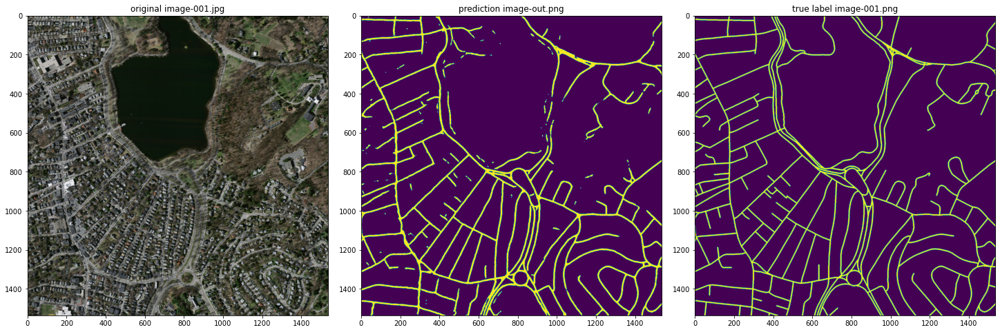

In [28]:
model.eval()
X_batch0, X_batch1 = next(iter(val_dataloader))
g = X_batch0.clone()
X_batch0 = X_batch0.to(device)

res = model(X_batch0)
res = (torch.stack((res[:, 0], res[:, 1]), dim=3)). \
    reshape(res.shape[0]*res.shape[2]*res.shape[3], n_classes)
res = res.argmax(dim=1)
res = res.reshape(X_batch0.shape[0], img_h, img_w)

for imgr, imgg, imgb in zip(res, g, X_batch1):
    show_three(imgg.cpu().detach(), imgr.cpu().detach(), imgb)

In [25]:
test_data = glob.glob('../input/massachusetts-roads-datasetrework/test_input/test_input/*.png')

test_labels = glob.glob('../input/massachusetts-roads-datasetrework/test_mask/test_mask/*.png')

test_dataset = ValDataset(sorted(val_data), sorted(val_labels))

test_dataloader = torch.utils.data.DataLoader(
    test_dataset, batch_size=1, shuffle=True, num_workers=batch_size, drop_last=True
)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


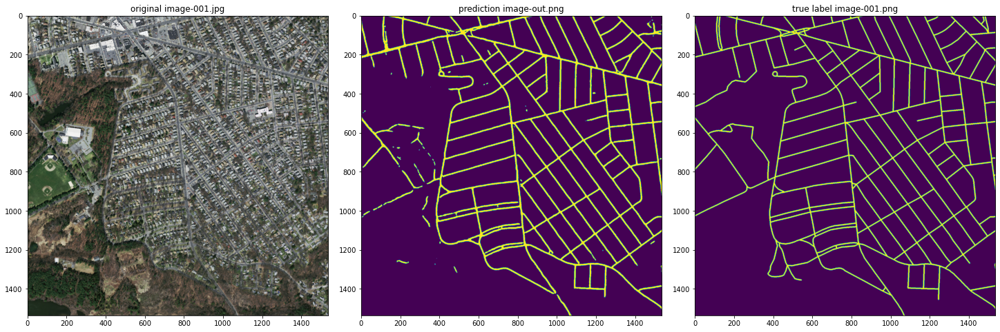

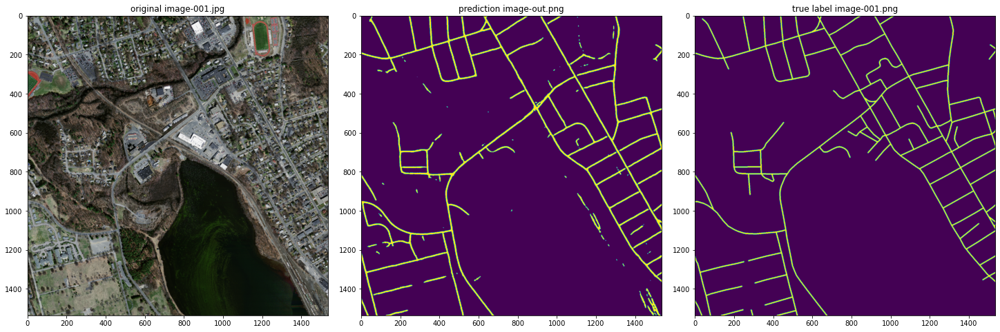

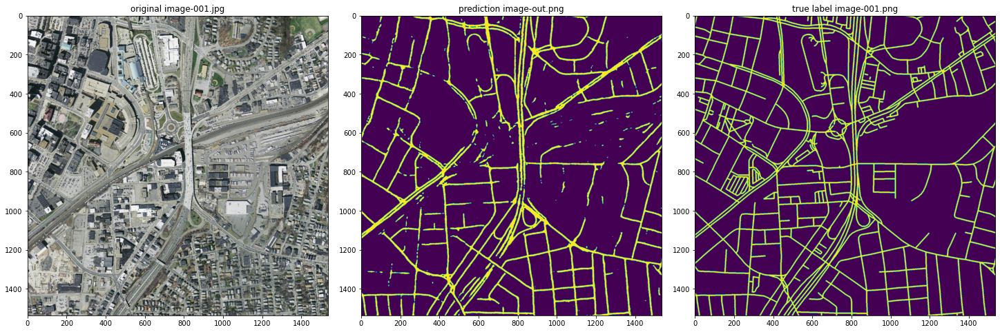

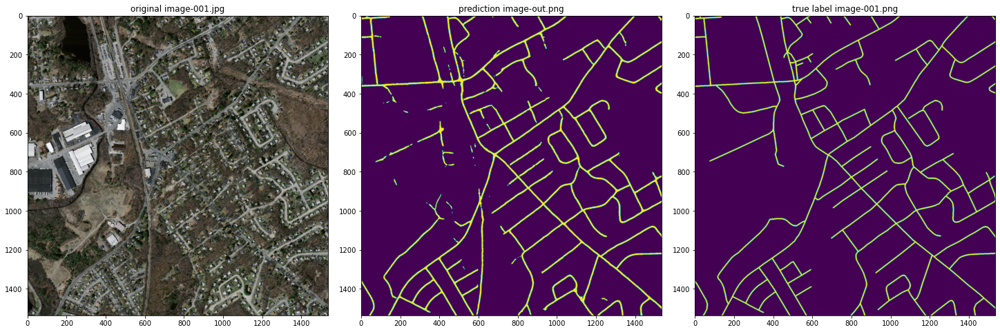

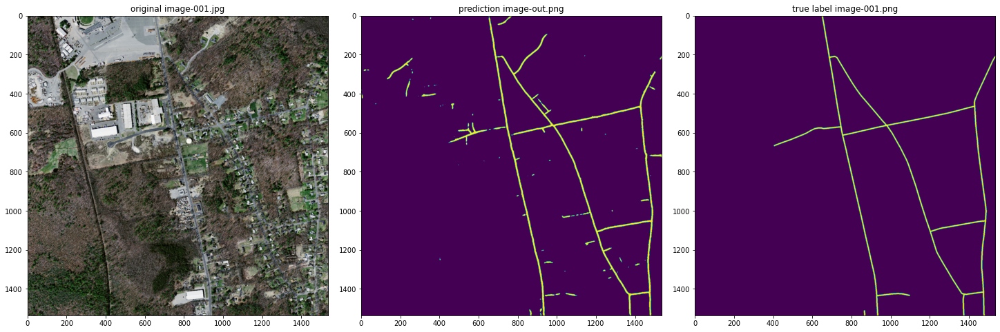

...

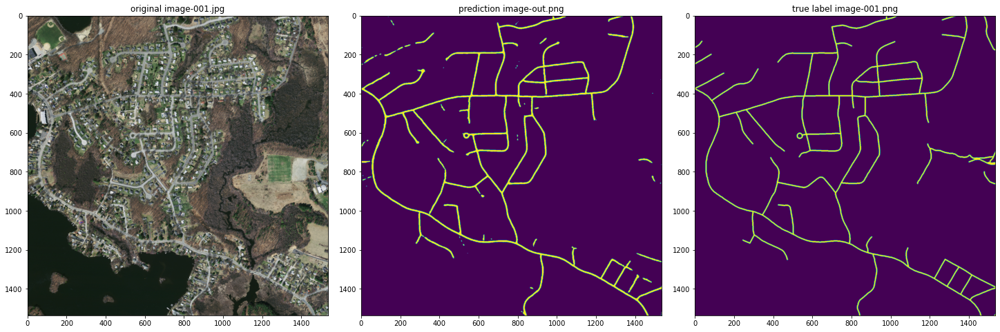

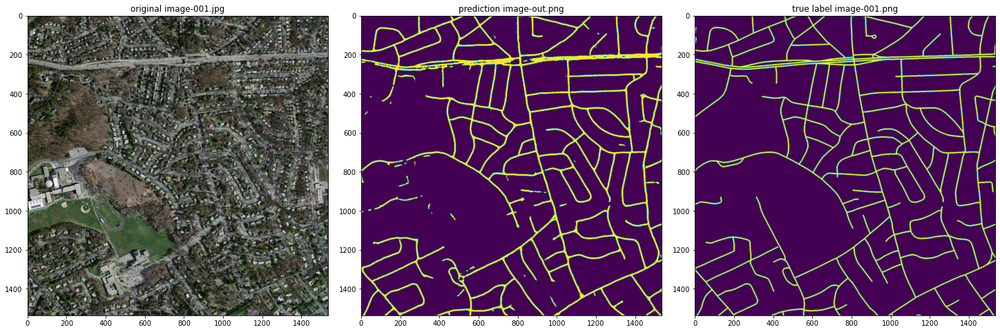

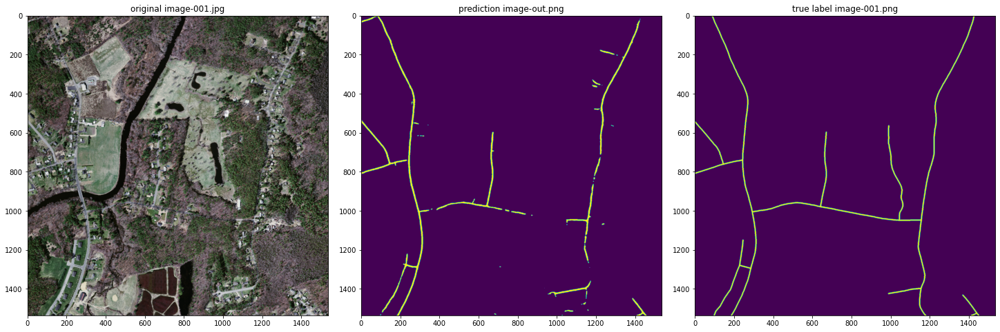

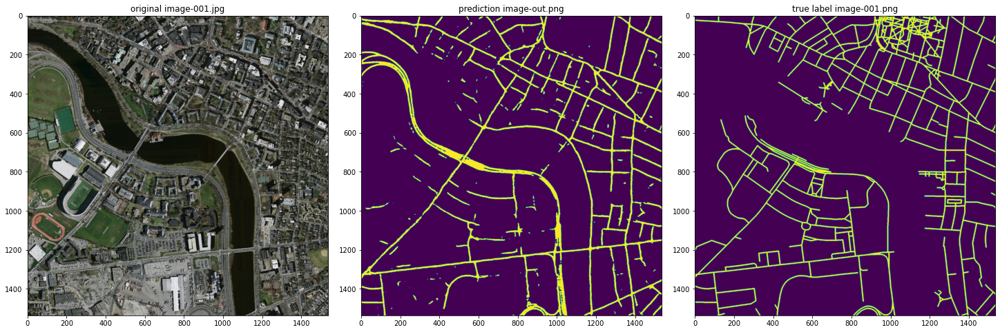

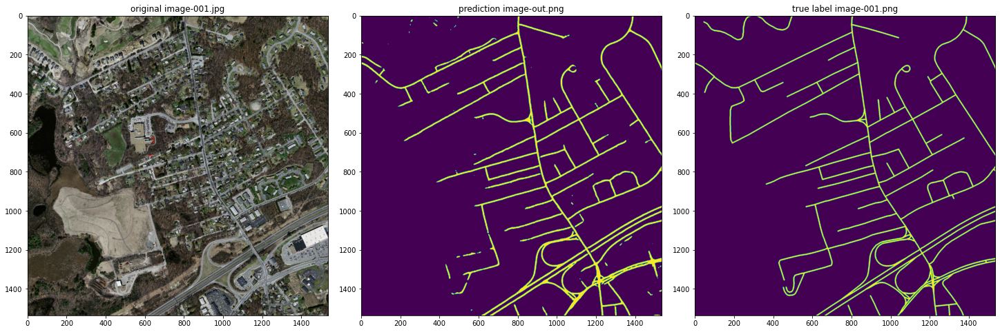

In [26]:
for i, (inputs, labels) in enumerate(test_dataloader):
    inputs = inputs.to(device)
    
    res = model(inputs)
    res = (torch.stack((res[:, 0], res[:, 1]), dim=3)). \
        reshape(res.shape[0]*res.shape[2]*res.shape[3], n_classes)
    res = res.argmax(dim=1)
    res = res.reshape(X_batch0.shape[0], img_h, img_w)
    
    for imgr, imgg, imgb in zip(res, inputs, labels):
        show_three(imgg.cpu().detach(), imgr.cpu().detach(), imgb)

In [27]:
torch.save(model, 'massachusetsroads.pth')